# Estudio Datos Vino

## Información de las variables

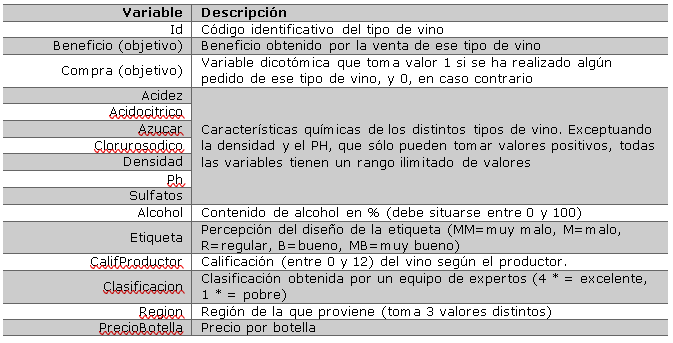

In [1]:
from IPython.display import Image

Image(filename='C:/Users/Kim/Desktop/Máster/mineria_datos/PARTE I_Depuracion y Regresiones/Dia1_MDDepuracion/datosVino.png')

# Depuración Variables
---

## Estudio descriptivo

In [2]:
import NuestrasFunciones
import pandas as pd
import numpy as np

In [3]:
pd.set_option("display.max_rows", None, "display.max_columns", None)

# Lectura de datos 
vinos = pd.read_csv('C:\\Users\\Kim\\Desktop\\Máster\\mineria_datos\\Datos\\DatosVino.csv')
vinos.head()

,ID,Beneficio,Compra,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,Etiqueta,CalifProductor,Clasificacion,Region,PrecioBotella
0,2,515,1,0.16,-0.81,26.10,-0.425,1.02792,3.38,0.70,144.0,M,2,***,1.0,1.00
1,4,585,1,2.64,-0.88,14.80,0.037,0.99518,3.12,0.48,22.0,M,3,***,3.0,3.38
2,8,0,0,0.29,-0.40,21.50,0.060,0.99572,3.49,1.21,10.3,R,3,?,1.0,3.72
3,11,775,1,-1.22,0.34,1.40,0.040,1.03236,3.20,NaN,11.6,B,2,***,2.0,6.23
4,12,596,1,0.27,1.05,11.25,-0.007,0.99620,4.93,0.26,15.0,R,1,?,2.0,2.44


Problemas del dataset observados a priori:

    - Hay características químicas distintos de densidad y Ph que son valores negativos
    - En alcohol hay un valor que supera el 100%
    - Clasificación hay una categoría que es '?'
    - Región es float

#### Tipos de variables 

In [4]:
vinos.info()
print('El dataset tiene {} filas y {} columnas'.format(vinos.shape[0], vinos.shape[1]))

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6365 entries, 0 to 6364
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   ID              6365 non-null   int64  
 1   Beneficio       6365 non-null   int64  
 2   Compra          6365 non-null   int64  
 3   Acidez          6365 non-null   float64
 4   AcidoCitrico    6365 non-null   float64
 5   Azucar          6365 non-null   float64
 6   CloruroSodico   6066 non-null   float64
 7   Densidad        6365 non-null   float64
 8   pH              6170 non-null   float64
 9   Sulfatos        5761 non-null   float64
 10  Alcohol         6365 non-null   float64
 11  Etiqueta        6365 non-null   object 
 12  CalifProductor  6365 non-null   int64  
 13  Clasificacion   6365 non-null   object 
 14  Region          6258 non-null   float64
 15  PrecioBotella   6365 non-null   float64
dtypes: float64(10), int64(4), object(2)
memory usage: 795.8+ KB
El dataset tiene 6

No todas las variables tienen asignado el tipo correcto de datos, como:
- Compra (columna 3), 
- Etiqueta (columna 12), 
- Clasificación (columna 14) y 
- Región (columna 15).

Variables con missings:
- CloruroSodico (columna 6)
- pH (columna 8)
- Sulfatos (columna 9)
- Region (columna 14)


#### Valores únicos

In [5]:
vinos.nunique()

ID                6365
Beneficio          983
Compra               2
Acidez             659
AcidoCitrico       523
Azucar            1639
CloruroSodico     1406
Densidad          3614
pH                 436
Sulfatos           543
Alcohol            312
Etiqueta            10
CalifProductor      13
Clasificacion        5
Region               3
PrecioBotella      598
dtype: int64

- Etiqueta sólo tendría que tener 5 valores únicos y hay 10, será por las mayúsculas.
- Clasificación tendría que tener 4 valores distintos y hay 5, por el valor '?'. 

#### Variables categóricas

Todas las columnas que tengan menos de 10 valores únicos pasan a ser categóricas.

- .iloc ➡️ index
- .loc ➡️ condición

In [6]:
#Lista de columnas con todas las filas, y sólo las columnas con menos de 10 valores distintos
to_factor = list(vinos.loc[:,vinos.nunique() <= 10]);  

In [7]:
to_factor

['Compra', 'Etiqueta', 'Clasificacion', 'Region']

In [8]:
# Podemos cambiar el tipo de todas ellas a factor de una vez
vinos[to_factor] = vinos[to_factor].astype('category')

In [9]:
vinos.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6365 entries, 0 to 6364
Data columns (total 16 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   ID              6365 non-null   int64   
 1   Beneficio       6365 non-null   int64   
 2   Compra          6365 non-null   category
 3   Acidez          6365 non-null   float64 
 4   AcidoCitrico    6365 non-null   float64 
 5   Azucar          6365 non-null   float64 
 6   CloruroSodico   6066 non-null   float64 
 7   Densidad        6365 non-null   float64 
 8   pH              6170 non-null   float64 
 9   Sulfatos        5761 non-null   float64 
 10  Alcohol         6365 non-null   float64 
 11  Etiqueta        6365 non-null   category
 12  CalifProductor  6365 non-null   int64   
 13  Clasificacion   6365 non-null   category
 14  Region          6258 non-null   category
 15  PrecioBotella   6365 non-null   float64 
dtypes: category(4), float64(9), int64(3)
memory usage: 622.5 KB


Miro a ver si Calificación del productor pueder ser también categórica:

In [10]:
import plotly.express as px
# Histograma de calificación del productor
fig = px.histogram(vinos, x="CalifProductor") 
fig.show()

Tiene una distribución asimétrica.

Si la dejo como continua: Se estimará un parámetro para toda la variable con el modelo de regresión. Si hay linealidad.

Si la convierto en categórica: Se estimará k-1 parámetros para la variable, el coste de convertirla son los grados de libertad que se come, más parámetros estimados, mayor complejidad del modelo. Si no hay linealidad

#### Descriptivos de las variables 

In [11]:
vinos.describe()

,ID,Beneficio,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,CalifProductor,PrecioBotella
count,6365.000000,6365.000000,6365.000000,6365.000000,6365.000000,6066.000000,6365.000000,6170.000000,5761.000000,6365.000000,6365.000000,6365.000000
mean,8010.702278,452.380204,0.331214,0.314350,4718.669780,0.051348,0.994204,3.202207,0.526659,16.250102,2.761508,2.610652
std,4654.939139,308.380542,0.787534,0.861428,21192.546521,0.322715,0.026417,0.678330,0.948039,25.598217,1.319127,1.480274
min,2.000000,0.000000,-2.790000,-3.240000,-127.100000,-1.171000,0.888090,0.540000,-3.120000,-4.500000,0.000000,1.000000
25%,3980.000000,236.000000,0.130000,0.020000,0.900000,-0.032750,0.988245,2.960000,0.280000,9.000000,2.000000,1.420000
50%,8065.000000,480.000000,0.280000,0.310000,5.000000,0.046000,0.994400,3.190000,0.500000,10.500000,3.000000,2.190000
75%,12027.000000,671.000000,0.650000,0.580000,22.600000,0.146750,1.000600,3.460000,0.880000,12.800000,3.000000,3.440000
max,16128.000000,1568.000000,3.680000,3.860000,99999.000000,1.351000,1.099240,6.050000,4.210000,150.000000,12.000000,11.440000


- Beneficio: Media < Mediana Hay valores bajos tirando de la media. Con una cola a la derecha un poco larga
- Azúcar: Máximo 99999.000000, valor que tira mucho de la media, es un dato que está mal registrado ➡️ Missing.


In [12]:
vinos.describe(include='category')

,Compra,Etiqueta,Clasificacion,Region
count,6365,6365,6365,6258.0
unique,2,10,5,3.0
top,1,R,**,3.0
freq,4998,2380,1754,2132.0


#### Inspección gráfica

In [13]:
import seaborn as sns
import matplotlib.pyplot as plt

def histogram_boxplot(data, xlabel = None, title = None, font_scale=2, figsize=(9,8), bins = None):
    """ Boxplot and histogram combined
    data: 1-d data array
    xlabel: xlabel 
    title: title
    font_scale: the scale of the font (default 2)
    figsize: size of fig (default (9,8))
    bins: number of bins (default None / auto)

    example use: histogram_boxplot(np.random.rand(100), bins = 20, title="Fancy plot")
    """
    # Definir tamaño letra
    sns.set(font_scale=font_scale)
    # Crear ventana para los subgráficos
    f2, (ax_box2, ax_hist2) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=figsize)
    # Crear boxplot
    sns.boxplot(x=data, ax=ax_box2)
    # Crear histograma
    sns.histplot(x=data, ax=ax_hist2, bins=bins) if bins else sns.histplot(x=data, ax=ax_hist2)
    # Pintar una línea con la media
    ax_hist2.axvline(np.mean(data),color='g',linestyle='-')
    # Pintar una línea con la mediana
    ax_hist2.axvline(np.median(data),color='y',linestyle='--')
    # Asignar título y nombre de eje si tal
    if xlabel: ax_hist2.set(xlabel=xlabel)
    if title: ax_box2.set(title=title, xlabel="")
    # Mostrar gráfico
    plt.show()
    
def cat_plot(col):
     if col.dtypes == 'category':
        fig = px.bar(col.value_counts())
        #fig = sns.countplot(x=col)
        return(fig.show())
def plot(col):
     if col.dtypes != 'category':
        print('Cont')
        histogram_boxplot(col, xlabel = col.name, title = 'Distibución continua')
     else:
        print('Cat')
        cat_plot(col)

Cont


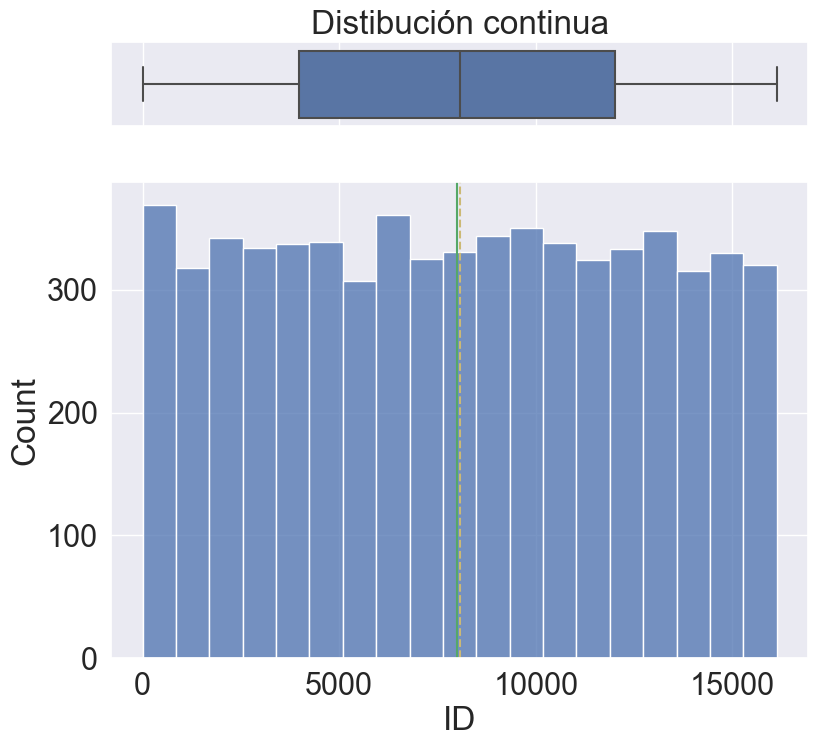

Cont


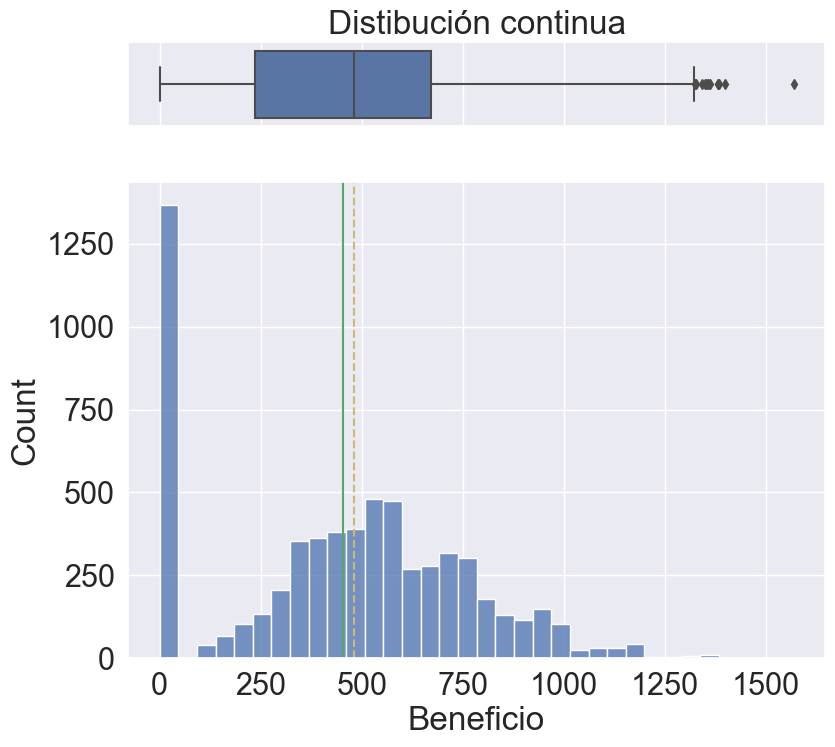

Cat


Cont


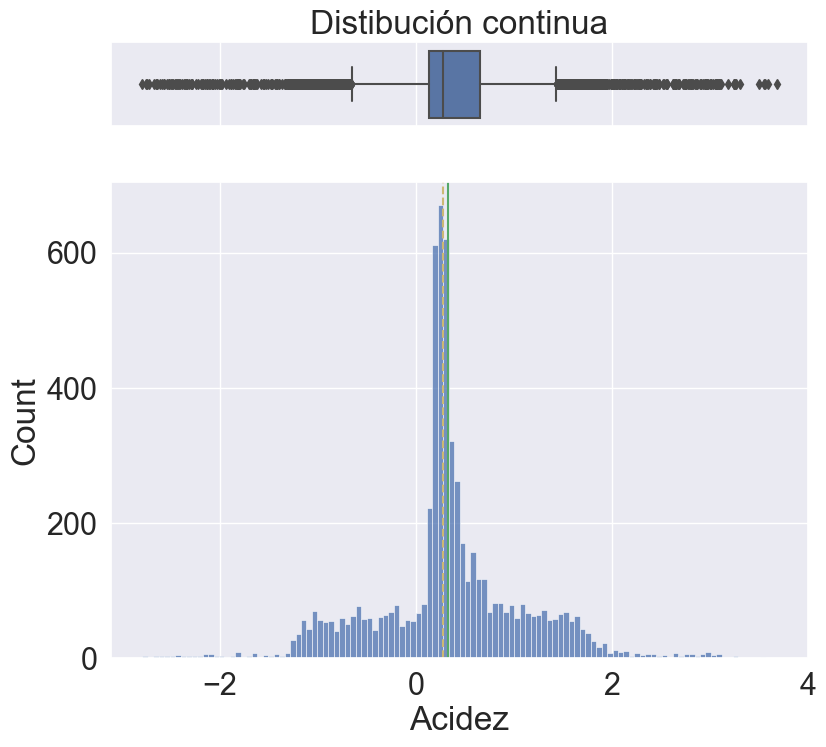

Cont


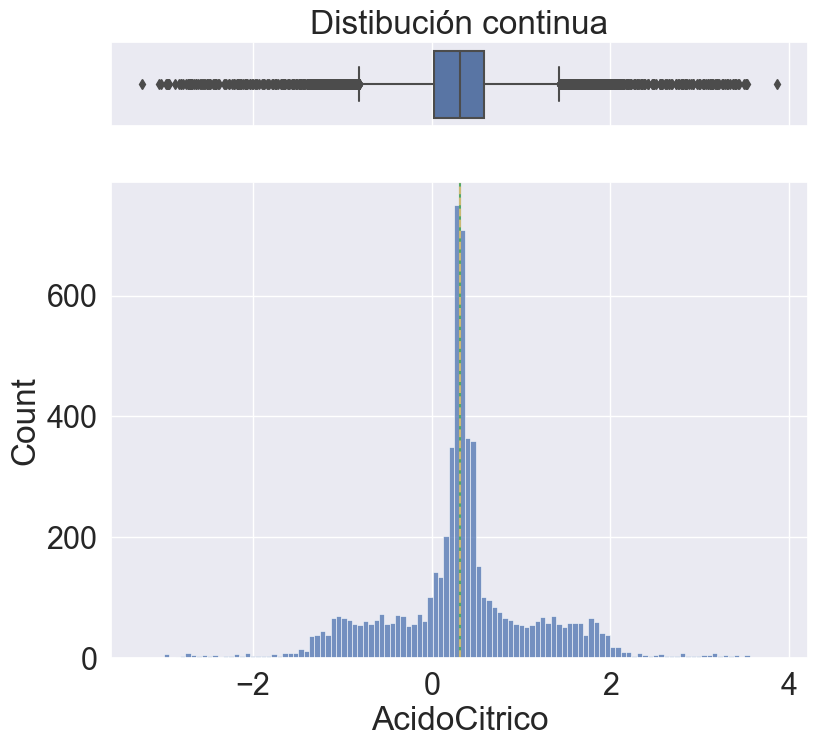

Cont


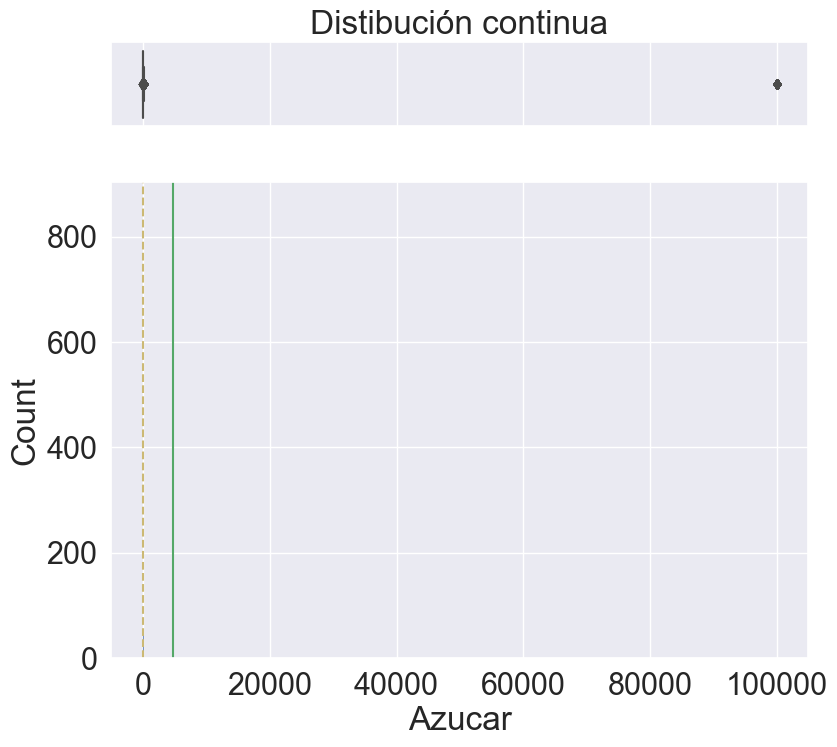

Cont


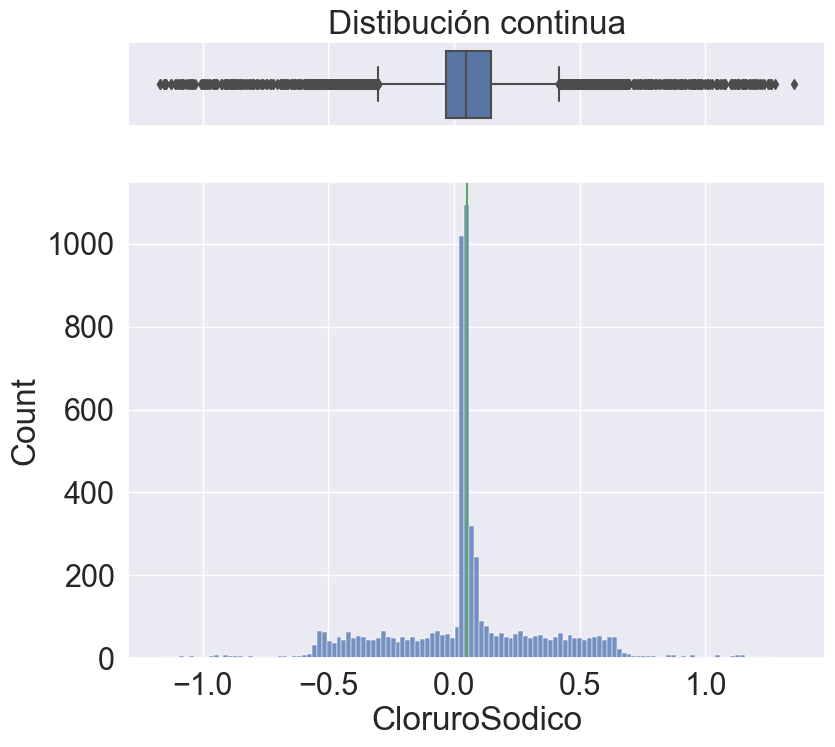

Cont


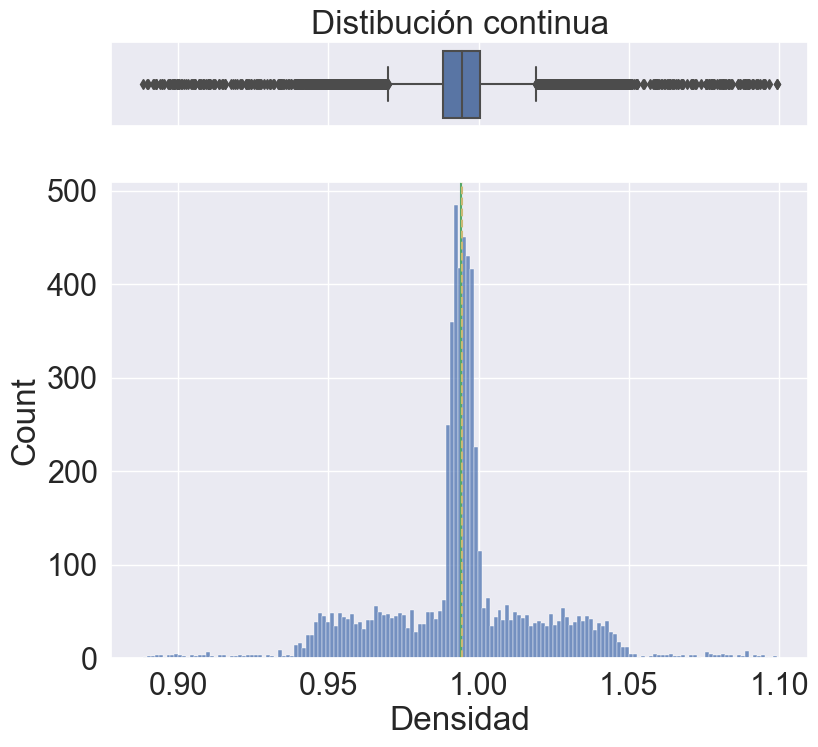

Cont


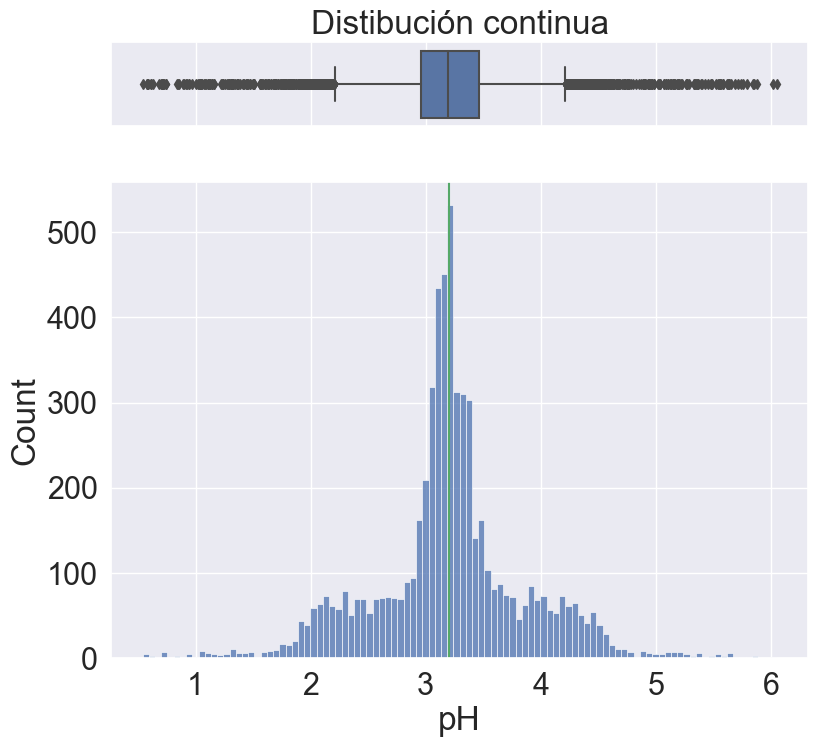

Cont


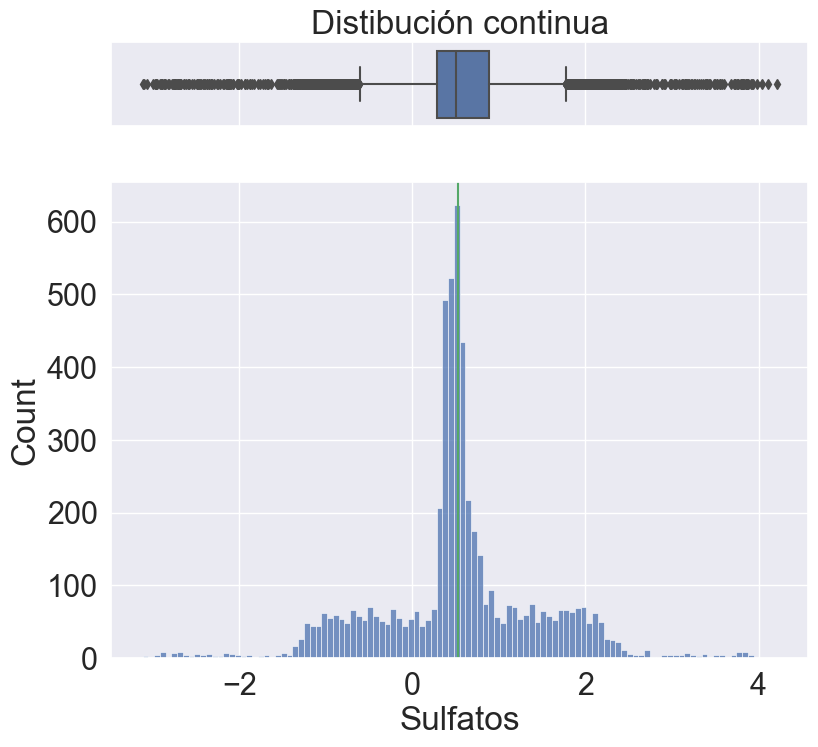

Cont


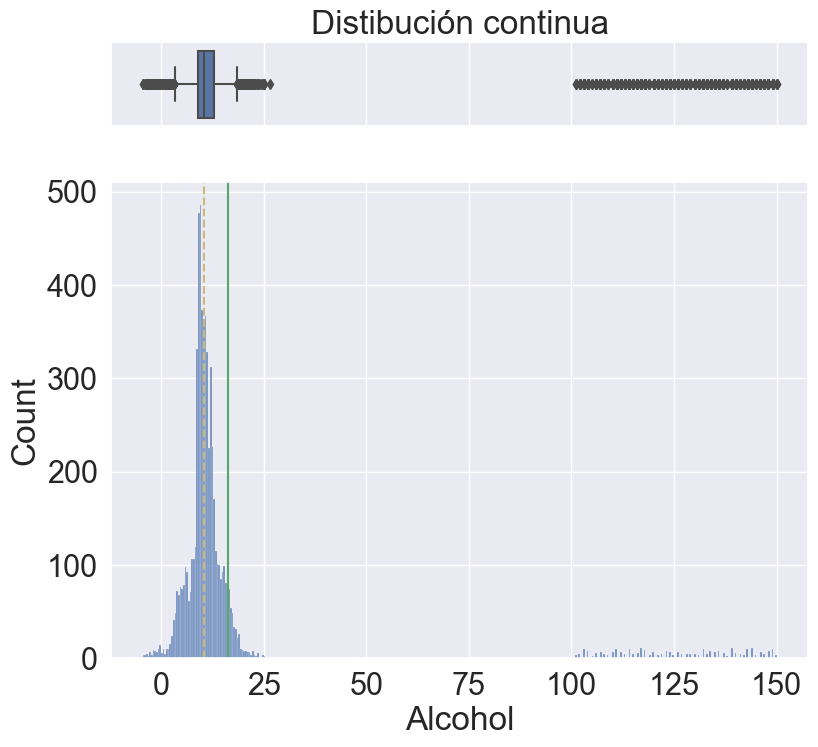

Cat


Cont


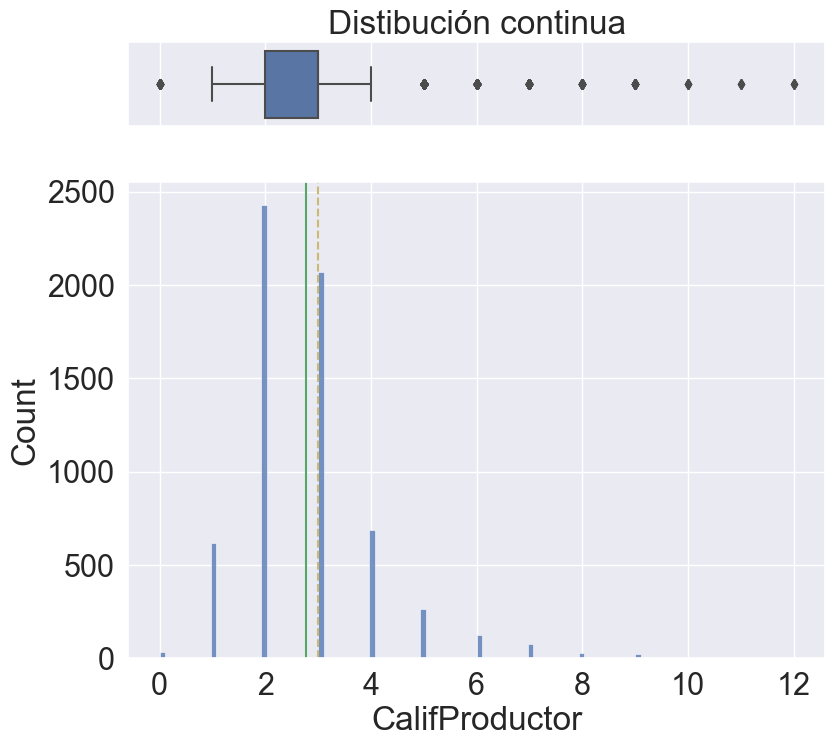

Cat


Cat


Cont


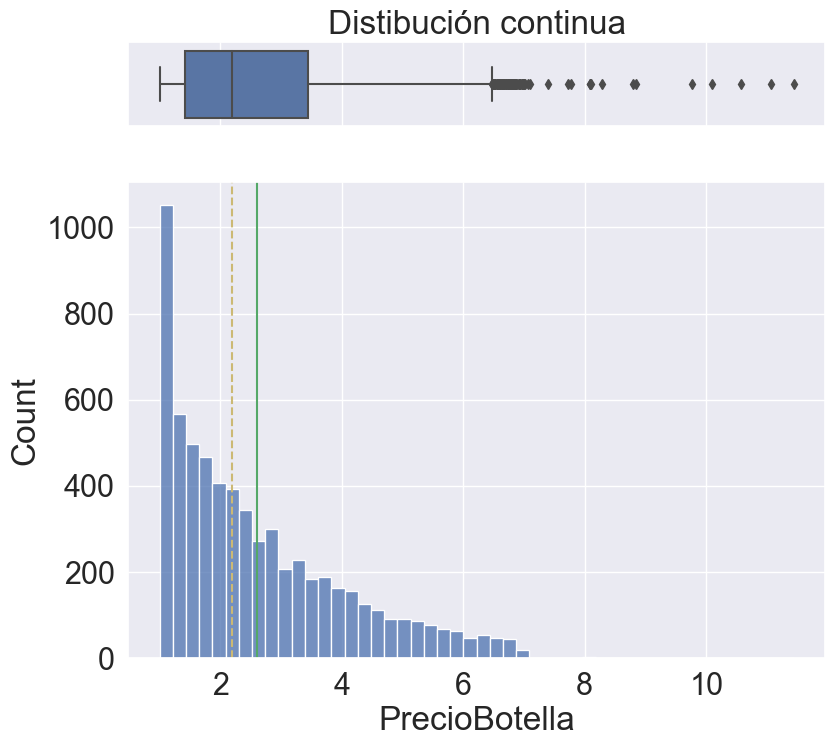

ID                None
Beneficio         None
Compra            None
Acidez            None
AcidoCitrico      None
Azucar            None
CloruroSodico     None
Densidad          None
pH                None
Sulfatos          None
Alcohol           None
Etiqueta          None
CalifProductor    None
Clasificacion     None
Region            None
PrecioBotella     None
dtype: object

In [14]:
vinos.apply(plot)

## Correción de errores detectados
---

#### Etiqueta 

In [15]:
#Frecuencia relativa
vinos['Etiqueta'].value_counts(normalize=True)

R     0.373920
M     0.213197
B     0.201414
r     0.065986
m     0.036135
MM    0.033936
b     0.032836
MB    0.030008
mb    0.006284
mm    0.006284
Name: Etiqueta, dtype: float64

In [16]:
#Paso todos los valores a mayúsculas
vinos['Etiqueta'] = vinos['Etiqueta'].str.upper().astype('category')

In [17]:
#Ordeno el orden de las etiquetas
vinos['Etiqueta'] = vinos['Etiqueta'].cat.reorder_categories(['MM','M','R','B','MB'])
vinos['Etiqueta'].value_counts(sort=False)

MM     256
M     1587
R     2800
B     1491
MB     231
Name: Etiqueta, dtype: int64

#### Azúcar

In [18]:
vinos['Azucar'].max()

99999.0

Sustituyo el valor 99999.0 por un valor nan

In [19]:
vinos['Azucar'].replace(99999, np.nan, inplace=True)
#Compruebo el nuevo valor máximo
vinos['Azucar'].max()

141.15

Ahora sí se puede ver la distribución de azúcar

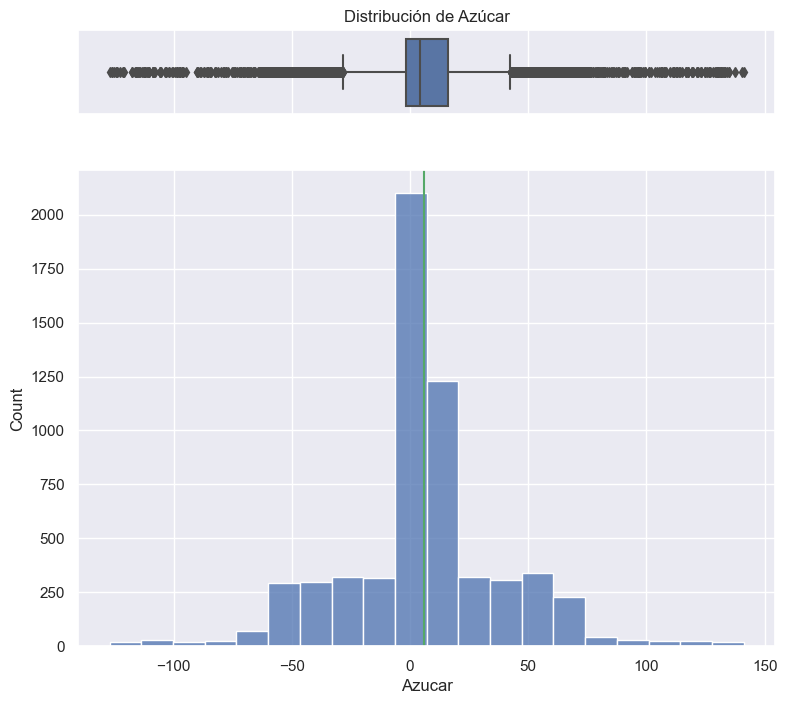

In [20]:
histogram_boxplot(vinos.Azucar, bins = 20, font_scale=1, title="Distribución de Azúcar")

#### Alcohol

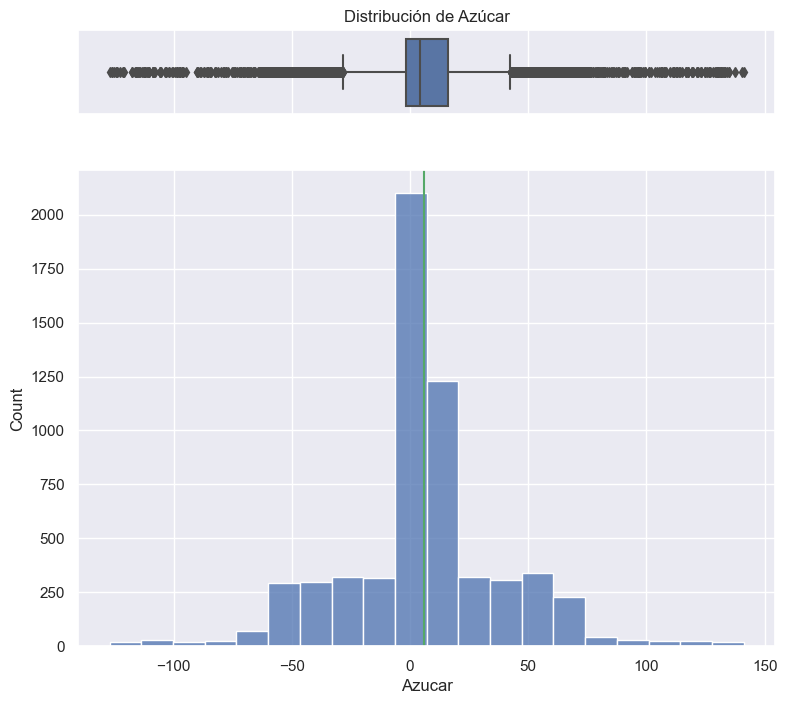

In [21]:
#Para las filas que no estén entre 0 y 100, se convierte en nan
vinos.loc[~vinos['Alcohol'].between(0,100), 'Alcohol'] = np.nan

#Compruebo la distribución resultante
histogram_boxplot(vinos.Azucar, bins = 20, font_scale=1, title="Distribución de Azúcar")

#### Clasificación

In [22]:
#Frecuencias de la variable Clasificación
vinos['Clasificacion'].value_counts()

**      1754
?       1680
*       1535
***     1074
****     322
Name: Clasificacion, dtype: int64

In [23]:
# Tabla de contingencia con la variable objetivo binaria Compra
pd.crosstab(index=vinos['Compra'], columns=vinos['Clasificacion'])

Clasificacion,*,**,***,****,?
Compra,,,,,
0,306,46,0,0,1015
1,1229,1708,1074,322,665


Como no hay datos para los vinos que no se compran de 3 y 4 estrellas, el modelo estará mal especificado

Por otro lado, la categoría '?' no se parece a ninguna otra categoría, porque tiene muchos más más 0 que 1. Podrían ser vinos malos

In [24]:
#Cambio los valores '?' por 'Desc'
vinos['Clasificacion'].replace('?','Desc', inplace=True)

## Variables objetivo
---

In [25]:
varObjCont = vinos['Beneficio']

In [26]:
# Variable objetivo continua
varObjCont = vinos['Beneficio']

#Variable objetivo binaria
varObjBin = vinos['Compra']

#Variables predictoras
imput = vinos.drop(['Beneficio', 'Compra'], axis=1)

## Valores atípicos 
---
Se considerarán valores extremos según un consenso de dos criterios distintos:
- Si es Simétrica: se aplica la media + 3 sd ó mediana + 8 mad. Todas las medidas de dispersión basadas en la mediana o cuartiles son muy poco sensibles a la presencia de asimetría en la distribución
- Si es Asimétrica: el criterio del boxplot umbrales en cuartil1 - 3IQR y cuartil3+ 3IQR.


#### Simetrías de las variables numéricas

In [27]:
vinos.skew(axis=0, numeric_only=True)

ID                0.003339
Beneficio         0.023872
Acidez            0.029079
AcidoCitrico     -0.024261
Azucar            0.022391
CloruroSodico     0.012041
Densidad         -0.009353
pH                0.003311
Sulfatos         -0.062373
Alcohol           0.267099
CalifProductor    1.663553
PrecioBotella     1.120795
dtype: float64

Todas las características químicas, junto con el beneficio son aproximadamente simétricas, pero CalifProductor y PrecioBotella no 

#### Función manual para winsorizar con clip+quantile 

In [28]:
def winsorize_with_pandas(s, limits):
    return s.clip(lower=s.quantile(limits[0], interpolation='lower'), 
                  upper=s.quantile(1-limits[1], interpolation='higher'))

#### Función para gestionar outliers

In [29]:
def gestiona_outliers(col,clas = 'check'):
    
     print(col.name)
     # Condición de asimetría y aplicación de criterio 1 según el caso. 
     #Si la variable es simétrica, se aplica la media + 3 sd
     #Si es asimétrica se alica mediana + 8 mad.  
     if abs(col.skew()) < 1:
        criterio1 = abs((col-col.mean())/col.std())>3
     else:
        criterio1 = abs((col-col.median())/col.mad())>8
     
     # Calcular primer cuartil     
     q1 = col.quantile(0.25)  
     # Calcular tercer cuartil  
     q3 = col.quantile(0.75)
     # Calcular el IQR
     IQR=q3-q1
     # Calcular criterio 2 (general para cualquier asimetría)
     criterio2 = (col<(q1 - 3*IQR))|(col>(q3 + 3*IQR))

     lower = col[criterio1&criterio2&(col<q1)].count()/col.dropna().count()
     upper = col[criterio1&criterio2&(col>q3)].count()/col.dropna().count()
     # Salida se gún el tipo deseado
     if clas == 'check':
            return(lower*100,upper*100,(lower+upper)*100)
     elif clas == 'winsor':
            return(winsorize_with_pandas(col,(lower,upper)))
     elif clas == 'miss':
            print('\n MissingAntes: ' + str(col.isna().sum()))
            col.loc[criterio1&criterio2] = np.nan
            print('MissingDespues: ' + str(col.isna().sum()) +'\n')
            return(col)

In [30]:
# Llamada en modo check 
imput.select_dtypes(include=np.number).copy().apply(lambda x : gestiona_outliers(x))

ID
Acidez
AcidoCitrico
Azucar
CloruroSodico
Densidad
pH
Sulfatos
Alcohol
CalifProductor
PrecioBotella


C:\Users\Kim\AppData\Local\Temp\ipykernel_11012\1848856640.py:10: FutureWarning:

The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.

C:\Users\Kim\AppData\Local\Temp\ipykernel_11012\1848856640.py:10: FutureWarning:

The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.



,ID,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,CalifProductor,PrecioBotella
0,0.0,0.816968,0.848390,0.956307,0.807781,0.942655,0.794165,1.024128,0.000000,0.000000,0.0
1,0.0,0.879811,0.785546,0.972795,0.873722,0.942655,0.696921,0.815831,0.317885,0.094266,0.0
2,0.0,1.696779,1.633936,1.929101,1.681503,1.885310,1.491086,1.839958,0.317885,0.094266,0.0


Los valores fuera del rango en total, tanto por debajo como por arriba, no supera el 20% de los registros.

In [31]:
# Copia con las variables continuas para winsorizar
vinCont = imput.select_dtypes(include=np.number).copy()
vinos_winsor = vinCont.apply(lambda x: gestiona_outliers(x,clas='winsor'))

ID
Acidez
AcidoCitrico
Azucar
CloruroSodico
Densidad
pH
Sulfatos
Alcohol
CalifProductor
PrecioBotella


C:\Users\Kim\AppData\Local\Temp\ipykernel_11012\1848856640.py:10: FutureWarning:

The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.

C:\Users\Kim\AppData\Local\Temp\ipykernel_11012\1848856640.py:10: FutureWarning:

The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.



In [32]:
# Juntar variables continuas winsorizadas con las variables categóricas 
imput_wins = vinos_winsor.join(imput.select_dtypes(exclude=np.number))
imput_wins.head()

,ID,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,CalifProductor,PrecioBotella,Etiqueta,Clasificacion,Region
0,2,0.16,-0.81,26.10,-0.425,1.02792,3.38,0.70,NaN,2,1.00,M,***,1.0
1,4,2.64,-0.88,14.80,0.037,0.99518,3.12,0.48,22.0,3,3.38,M,***,3.0
2,8,0.29,-0.40,21.50,0.060,0.99572,3.49,1.21,10.3,3,3.72,R,Desc,1.0
3,11,-1.22,0.34,1.40,0.040,1.03236,3.20,NaN,11.6,2,6.23,B,***,2.0
4,12,0.27,1.05,11.25,-0.007,0.99620,4.93,0.26,15.0,1,2.44,R,Desc,2.0


Las variables predictoras ya están gestionadas correctamente en cuanto a outliers

## Valores perdidos
---

#### Missings por variable

In [33]:
imput_wins.apply(lambda x: x.isna().sum()/x.count()*100)

ID                 0.000000
Acidez             0.000000
AcidoCitrico       0.000000
Azucar             4.946414
CloruroSodico      4.929113
Densidad           0.000000
pH                 3.160454
Sulfatos          10.484291
Alcohol            6.491551
CalifProductor     0.000000
PrecioBotella      0.000000
Etiqueta           0.000000
Clasificacion      0.000000
Region             1.709811
dtype: float64

La variable con más missings es Sulfatos, con un 10,48% de incidencia

#### Missings por registro

Creo una nueva variable con el porcentaje de missings que tiene cada registro

In [34]:
imput_wins['prop_missings'] = imput_wins.apply(lambda x: x.isna().sum()/x.count()*100,axis=1)

In [35]:
imput_wins['prop_missings'] = imput_wins['prop_missings'].astype('category')

In [36]:
imput_wins.prop_missings.describe()

count     6365.0
unique       4.0
top          0.0
freq      4692.0
Name: prop_missings, dtype: float64

Los registros con mayor proporción de missings

In [37]:
imput_wins.sort_values(by='prop_missings', ascending=False).head()

,ID,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,CalifProductor,PrecioBotella,Etiqueta,Clasificacion,Region,prop_missings
2781,6990,1.40,0.30,NaN,NaN,1.04263,4.00,NaN,15.1,3,1.30,R,**,2.0,27.272727
1344,3341,0.26,0.27,18.2,0.048,1.04227,NaN,NaN,3.8,1,2.62,B,**,NaN,27.272727
5402,13598,-0.45,0.26,NaN,NaN,0.99907,2.21,0.68,NaN,3,3.10,M,Desc,1.0,27.272727
4385,11020,0.27,-0.01,NaN,0.295,0.99566,NaN,-0.46,NaN,3,2.35,R,**,2.0,27.272727
1352,3357,1.02,1.51,NaN,NaN,0.99300,3.37,0.55,11.5,2,1.60,MB,Desc,NaN,27.272727


Los registros con mayor proporción de missings, suelen ser por las variables químicas: Azucar, CloruroSodico, Sulfatos y Alcohol.

#### Patrón de valores perdidos

<AxesSubplot: >

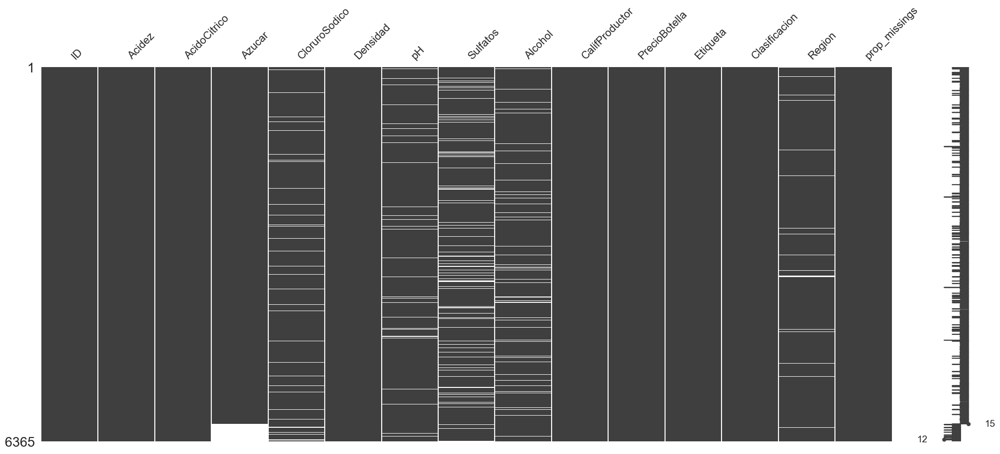

In [38]:
import missingno as msno 
msno.matrix(imput_wins.sort_values(by='Azucar'))

<AxesSubplot: >

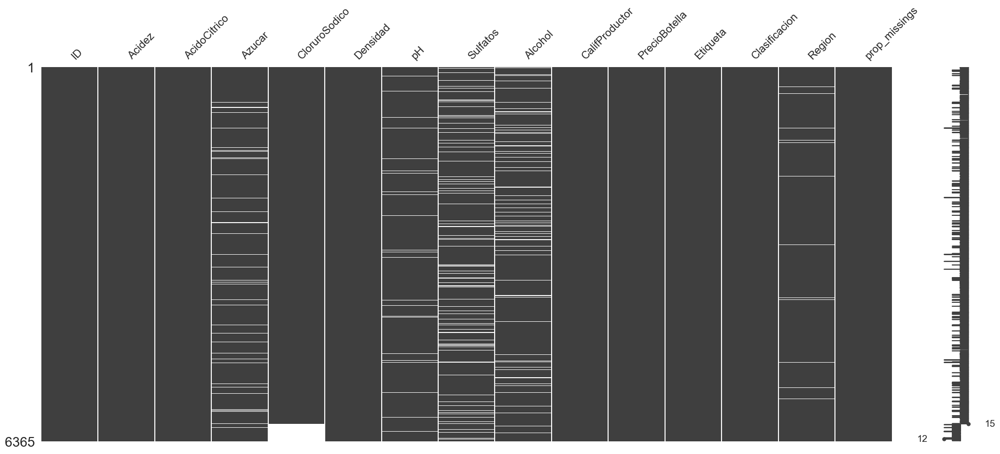

In [39]:

msno.matrix(imput_wins.sort_values(by='CloruroSodico'))

<AxesSubplot: >

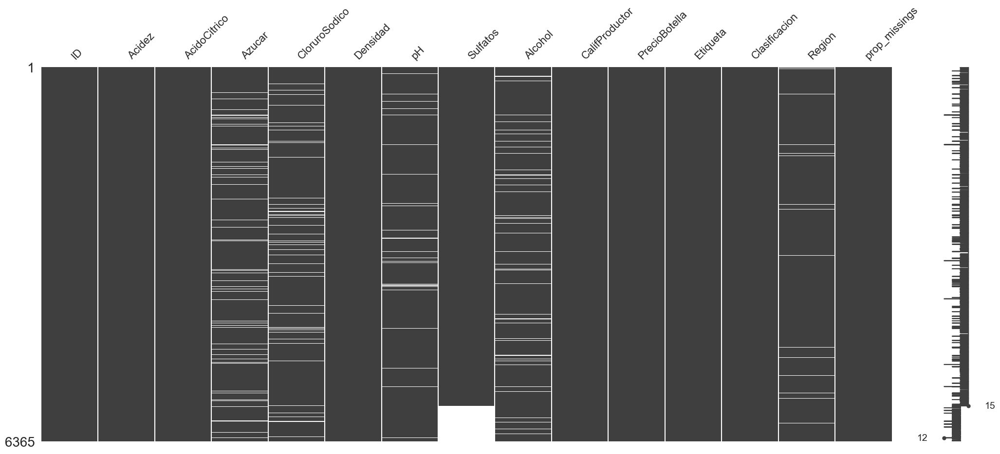

In [40]:
msno.matrix(imput_wins.sort_values(by='Sulfatos'))

<AxesSubplot: >

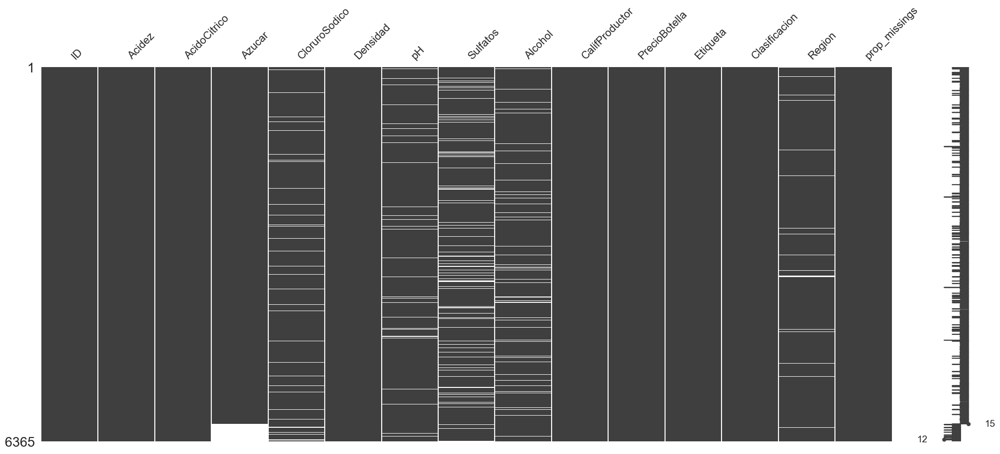

In [41]:
msno.matrix(imput_wins.sort_values(by='Azucar'))

No hay patrón de Missings

#### ¿Eliminar missings?

Las observaciones que se perderían si elimino por lista los missings

In [42]:
imput_wins.describe(exclude=np.number)

,Etiqueta,Clasificacion,Region,prop_missings
count,6365,6365,6258.0,6365.0
unique,5,5,3.0,4.0
top,R,**,3.0,0.0
freq,2800,1754,2132.0,4692.0


In [43]:
imput_wins.dropna().describe(exclude=np.number)

,Etiqueta,Clasificacion,Region,prop_missings
count,4692,4692,4692.0,4692.0
unique,5,5,3.0,1.0
top,R,**,3.0,0.0
freq,2077,1341,1605.0,4692.0


In [44]:
(1-(4692/6365))*100

26.284367635506676

No es buena idea eliminar estas observaciones, ya que eliminaría el 26.28% de los registros

#### Imputaciones

Antes de imputar, separo las variables continuas y las variables categóricas

In [45]:
imput_wins_cont = imput_wins.select_dtypes(include = np.number)
imput_wins_cat = imput_wins.select_dtypes(exclude = np.number)

##### Variables continuas - Media

In [46]:
import feature_engine.imputation as fe_imp
imputer_mean = fe_imp.MeanMedianImputer(imputation_method='mean')
vinos_winsor_mean_imputed = imputer_mean.fit(imput_wins_cont).transform(imput_wins_cont)

##### Variables continuas - Mediana

In [47]:
imputer_median = fe_imp.MeanMedianImputer(imputation_method='median')
vinos_winsor_median_imputed = imputer_median.fit(imput_wins_cont).transform(imput_wins_cont)

##### Variables continuas - Knn

In [48]:
import sklearn.impute as skl_imp
imputer_knn = skl_imp.KNNImputer(n_neighbors=3)
imput_wins_knn_imputed = pd.DataFrame(imputer_knn.fit_transform(imput_wins_cont),columns=imput_wins_cont.columns)

##### Variables continuas - Iterativo

In [49]:
from sklearn.experimental import enable_iterative_imputer
imputer_itImp = skl_imp.IterativeImputer(max_iter=10, random_state=0)
imput_wins_itImp_imputed = pd.DataFrame(imputer_itImp.fit_transform(imput_wins_cont),columns=imput_wins_cont.columns)

##### Variables categóricas - Moda

In [50]:
imputer_moda = skl_imp.SimpleImputer(strategy='most_frequent', missing_values=np.nan)
imput_wins_moda_imputed = pd.DataFrame(imputer_moda.fit_transform(imput_wins_cat),columns=imput_wins_cat.columns)

##### Todas las variables - Aleatoria

In [51]:
imputer_rand = fe_imp.RandomSampleImputer()
imput_wins_rand_imputed = imputer_rand.fit(imput_wins).transform(imput_wins)

##### Decisión

**Distribución original**

In [52]:
imput_wins['Sulfatos'].describe()

count    5761.000000
mean        0.527606
std         0.926347
min        -2.320000
25%         0.280000
50%         0.500000
75%         0.880000
max         3.380000
Name: Sulfatos, dtype: float64

In [53]:
imput_wins['Region'].describe()

count     6258.0
unique       3.0
top          3.0
freq      2132.0
Name: Region, dtype: float64

**Las distintas imputaciones**

In [54]:
vinos_winsor_mean_imputed['Sulfatos'].describe()

count    6365.000000
mean        0.527606
std         0.881292
min        -2.320000
25%         0.330000
50%         0.527606
75%         0.770000
max         3.380000
Name: Sulfatos, dtype: float64

In [55]:
vinos_winsor_median_imputed['Sulfatos'].describe()

count    6365.000000
mean        0.524987
std         0.881329
min        -2.320000
25%         0.330000
50%         0.500000
75%         0.770000
max         3.380000
Name: Sulfatos, dtype: float64

In [56]:
imput_wins_knn_imputed['Sulfatos'].describe()

count    6365.000000
mean        0.530157
std         0.895788
min        -2.320000
25%         0.270000
50%         0.500000
75%         0.880000
max         3.380000
Name: Sulfatos, dtype: float64

In [57]:
imput_wins_itImp_imputed['Sulfatos'].describe()

count    6365.000000
mean        0.527595
std         0.881295
min        -2.320000
25%         0.330000
50%         0.521155
75%         0.770000
max         3.380000
Name: Sulfatos, dtype: float64

In [58]:
imput_wins_moda_imputed['Region'].describe()

count     6365.0
unique       3.0
top          3.0
freq      2239.0
Name: Region, dtype: float64

In [59]:
imput_wins_rand_imputed['Sulfatos'].describe()

count    6365.000000
mean        0.523906
std         0.926729
min        -2.320000
25%         0.270000
50%         0.500000
75%         0.880000
max         3.380000
Name: Sulfatos, dtype: float64

Me quedo con imput_wins_rand_imputed porque es el que menos subestima la desviación estándar

In [60]:
vinosDep = pd.concat([imput_wins_rand_imputed, varObjCont,varObjBin], axis=1)

Reordeno el orden de la variable 'Clasificacion'

In [61]:
vinosDep["Clasificacion"] = vinosDep["Clasificacion"].cat.reorder_categories(['Desc','*','**','***','****'])

In [62]:
vinosDep['Clasificacion'].value_counts(sort=False)

Desc    1680
*       1535
**      1754
***     1074
****     322
Name: Clasificacion, dtype: int64

## Variables de control
---

Para discernir efectoes espurios de efectos verdaderos frente a la variable objetivo

In [63]:
vinosDep['aleatorio'] = np.random.uniform(0,1,size=vinosDep.shape[0])
vinosDep['aleatorio2'] = np.random.uniform(0,1,size=vinosDep.shape[0])
vinosDep.head()

,ID,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,CalifProductor,PrecioBotella,Etiqueta,Clasificacion,Region,prop_missings,Beneficio,Compra,aleatorio,aleatorio2
0,2,0.16,-0.81,26.10,-0.425,1.02792,3.38,0.70,11.5,2,1.00,M,***,1.0,7.692308,515,1,0.236643,0.721304
1,4,2.64,-0.88,14.80,0.037,0.99518,3.12,0.48,22.0,3,3.38,M,***,3.0,0.000000,585,1,0.221509,0.373935
2,8,0.29,-0.40,21.50,0.060,0.99572,3.49,1.21,10.3,3,3.72,R,Desc,1.0,0.000000,0,0,0.772721,0.021496
3,11,-1.22,0.34,1.40,0.040,1.03236,3.20,0.34,11.6,2,6.23,B,***,2.0,7.692308,775,1,0.900832,0.814474
4,12,0.27,1.05,11.25,-0.007,0.99620,4.93,0.26,15.0,1,2.44,R,Desc,2.0,0.000000,596,1,0.518076,0.518672


## Reporte descriptivo de las variables
---

In [64]:
import pandas_profiling
pandas_profiling.ProfileReport(vinosDep)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Etiqueta y Clasificación están fuertemente correladas con Beneficio

Me quedo sólo con los vinos que se compran, es decir, Compra = 1

In [65]:
vinosCompra = vinosDep.loc[vinosDep.Compra == 1].drop(['Compra'],axis=1).reset_index(drop=True)
vinosCompra.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4998 entries, 0 to 4997
Data columns (total 18 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   ID              4998 non-null   int64   
 1   Acidez          4998 non-null   float64 
 2   AcidoCitrico    4998 non-null   float64 
 3   Azucar          4998 non-null   float64 
 4   CloruroSodico   4998 non-null   float64 
 5   Densidad        4998 non-null   float64 
 6   pH              4998 non-null   float64 
 7   Sulfatos        4998 non-null   float64 
 8   Alcohol         4998 non-null   float64 
 9   CalifProductor  4998 non-null   int64   
 10  PrecioBotella   4998 non-null   float64 
 11  Etiqueta        4998 non-null   category
 12  Clasificacion   4998 non-null   category
 13  Region          4998 non-null   category
 14  prop_missings   4998 non-null   category
 15  Beneficio       4998 non-null   int64   
 16  aleatorio       4998 non-null   float64 
 17  aleatorio2    

## Variables objetivo
---

In [66]:
varObjCont = vinosCompra.Beneficio
imputCompra = vinosCompra.drop(['ID','Beneficio'],axis=1)
varObjCont.info()

<class 'pandas.core.series.Series'>
RangeIndex: 4998 entries, 0 to 4997
Series name: Beneficio
Non-Null Count  Dtype
--------------  -----
4998 non-null   int64
dtypes: int64(1)
memory usage: 39.2 KB


## Etiqueta y Clasificación
---


Miro cómo interactúan conjuntamente

In [67]:
pd.crosstab(vinosCompra['Etiqueta'],vinosCompra['Clasificacion'])

Clasificacion,Desc,*,**,***,****
Etiqueta,,,,,
MM,63,99,34,11,0
M,273,429,426,124,13
R,253,529,808,499,98
B,64,162,396,366,173
MB,12,10,44,74,38


No hay Vinos comprados con Etiqueta MM y Clasificación de 4 estrellas, decido unir las Etiquetas MM y M para solucionar este problema

In [68]:
imputCompra['Etiqueta'].value_counts(sort=False)

MM     207
M     1265
R     2187
B     1161
MB     178
Name: Etiqueta, dtype: int64

In [69]:
vinosCompra['Etiqueta_r'] = vinosCompra.Etiqueta.replace(['M','MM'],'M-MM',inplace=False)

Miro otra vez la interacción entre Etiqueta y Clasificación

In [70]:
pd.crosstab(vinosCompra.Etiqueta_r,vinosCompra.Clasificacion)

Clasificacion,Desc,*,**,***,****
Etiqueta_r,,,,,
M-MM,336,528,460,135,13
R,253,529,808,499,98
B,64,162,396,366,173
MB,12,10,44,74,38


## Transformación de variables continuas
---

In [71]:
# Busca la transformación de variables input de intervalo que maximiza la VCramer o la correlación tipo Pearson con la objetivo
from sklearn.preprocessing import scale

def mejorTransf (vv,target, name=False, tipo = 'cramer', graf=False):
    # Escalado de datos (evitar fallos de tamaño de float64 al hacer exp de número grande..cosas de python)
    vv = pd.Series(scale(vv), name=vv.name)
    
    # Traslación a valores positivos de la variable (sino falla log y las raíces!)
    vv = vv + abs(min(vv))+0.0001
      
    # Definimos y calculamos las tranformacione típicas  
    transf = pd.DataFrame({vv.name + '_ident': vv, vv.name + '_log': np.log(vv), vv.name + '_exp': np.exp(vv), 
                         vv.name + '_sqr': np.square(vv), vv.name + '_cuarta': vv**4, vv.name + '_raiz4': vv**(1/4)})
      
    # Distinguimos caso cramer o caso correlación
    if tipo == 'cramer':
      # Aplicar la función cramers_v a cada trasnformación frente a la respuesta
      tablaCramer = pd.DataFrame(transf.apply(lambda x: cramers_v(x,target)),columns=['VCramer'])
      
      # Si queremos gráfico, muestra comparativa entre las posibilidades
      if graf: px.bar(tablaCramer,x=tablaCramer.VCramer,title='Relaciones frente a ' + target.name).update_yaxes(categoryorder="total ascending").show()
      # Identificar mejor transfromación
      best = tablaCramer.query('VCramer == VCramer.max()').index
      ser = transf[best].squeeze()
    
    if tipo == 'cor':
      # Aplicar coeficiente de correlacion a cada trasnformación frente a la respuesta
      tablaCorr = pd.DataFrame(transf.apply(lambda x: np.corrcoef(x,target)[0,1]),columns=['Corr'])
      # Si queremos gráfico, muestra comparativa entre las posibilidades
      if graf: px.bar(tablaCorr,x=tablaCorr.Corr,title='Relaciones frente a ' + target.name).update_yaxes(categoryorder="total ascending").show()
      # identificar mejor transfromación
      best = tablaCorr.query('Corr.abs() == Corr.abs().max()').index
      ser = transf[best].squeeze()
  
    # Aquí distingue si se devuelve la variable transfromada o solamente el nombre de la transfromacion
    if name:
      return(ser.name)
    else:
      return(ser)

In [72]:
# Ejemplo de uso univariante
tr = mejorTransf(vinosCompra.Azucar,varObjCont, tipo='cor')

tr.head(),vinosCompra.Azucar.head()


(0    13.738576
 1    11.346927
 2     8.807006
 3    10.642745
 4     8.878171
 Name: Azucar_sqr, dtype: float64,
 0    26.10
 1    14.80
 2     1.40
 3    11.25
 4     1.80
 Name: Azucar, dtype: float64)

#### Mejor transformación de cada variable por correlación

In [74]:
# Aplicar a las variables continuas la mejor transfromación según correlacion frente a varObjCont
transf_cor = imputCompra.select_dtypes(include=np.number).apply(lambda x: mejorTransf(x,varObjCont, tipo='cor'))
# Pedir los nombres de las transromadas
transf_cor_names = imputCompra.select_dtypes(include=np.number).apply(lambda x: mejorTransf(x,varObjCont,tipo='cor', name=True))
# Asignar nombres a las columnas de salida del proceso
transf_cor.columns = transf_cor_names.values
transf_cor.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4998 entries, 0 to 4997
Data columns (total 12 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Acidez_sqr            4998 non-null   float64
 1   AcidoCitrico_exp      4998 non-null   float64
 2   Azucar_sqr            4998 non-null   float64
 3   CloruroSodico_log     4998 non-null   float64
 4   Densidad_raiz4        4998 non-null   float64
 5   pH_ident              4998 non-null   float64
 6   Sulfatos_cuarta       4998 non-null   float64
 7   Alcohol_raiz4         4998 non-null   float64
 8   CalifProductor_raiz4  4998 non-null   float64
 9   PrecioBotella_sqr     4998 non-null   float64
 10  aleatorio_log         4998 non-null   float64
 11  aleatorio2_sqr        4998 non-null   float64
dtypes: float64(12)
memory usage: 468.7 KB


#### Mejor transformación de cada variable por V de Cramer

In [75]:
# Librería estadística!
import scipy.stats as stats

# Función para calcular VCramer (dos nominales de entrada!)
def cramers_v(var1, varObj):
# Si la variable es continua, se tramifica    
    if not var1.dtypes == 'category':
        bins = min(5,var1.value_counts().count())
        var1 = pd.cut(var1, bins = 5)
    if not varObj.dtypes == 'category': #np.issubdtype(varObj, np.number):
        bins = min(5,varObj.value_counts().count())
        varObj = pd.cut(varObj, bins = 5)
        
    data = pd.crosstab(var1, varObj).values
    vCramer = stats.contingency.association(data, method = 'cramer')
    return vCramer
tablaCramer = pd.DataFrame(imputCompra.apply(lambda x: cramers_v(x,varObjCont)),columns=['VCramer'])

import plotly.express as px
px.bar(tablaCramer,x=tablaCramer.VCramer,title='Relaciones frente al Beneficio').update_yaxes(categoryorder="total ascending")

In [76]:
# Aplicar a las variables continuas la mejor transfromación según cramer frente a varObjCont
transf_cramer = imputCompra.select_dtypes(include=np.number).apply(lambda x: mejorTransf(x,varObjCont, tipo='cramer'))
transf_cramer_names = imputCompra.select_dtypes(include=np.number).apply(lambda x: mejorTransf(x,varObjCont,tipo='cramer', name=True))
transf_cramer.columns = transf_cramer_names.values

#### Transformaciones + Variables Originales

In [77]:
imput_transf_cor = imputCompra.join(transf_cor)
imput_transf_cramer = imputCompra.join(transf_cramer)

#### Transformaciones + Variables Originales + Variable Objetivo Continua

In [78]:
todo_cont_cor = pd.concat([imput_transf_cor,varObjCont],axis=1)
todo_cont_cramer = pd.concat([imput_transf_cramer,varObjCont],axis=1)

In [80]:
import plotly.express as px
tablaCramer_sorted = tablaCramer.sort_values(by='VCramer', ascending=True)
px.bar(tablaCramer_sorted, x=tablaCramer_sorted.VCramer, 
             title='Relaciones frente a Beneficio')

Las variables continuas no aportaran mucho al modelo de regresión, pero puede ser que en presencia de otras variables, la infuencia de estas aumente.

Para conseguir una mayor influencia de las variables continuas, las tramifico

In [ ]:
from optbinning import ContinuousOptimalBinning
optb = ContinuousOptimalBinning(name='CalifProductor', dtype="numerical", max_n_bins=3)
optb.fit(imput_transf_cor['Azucar'].values, varObjCont)

x_transform_bins = optb.transform(imput_transf_cor['Azucar'].values, metric="bins")
x_transform_bins

# Modelo de regresión
---

#### Partición en Training-Test

In [82]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(imputCompra, varObjCont, test_size=0.2, random_state=42)
print('Training dataset shape:', X_train.shape, y_train.shape)
print('Testing dataset shape:', X_test.shape, y_test.shape)

Training dataset shape: (3998, 16) (3998,)
Testing dataset shape: (1000, 16) (1000,)


In [83]:
# Genero el training con la objetivo dentro para utilizar la interfaz fórmula
data_train = X_train.join(y_train)
data_train

,Acidez,AcidoCitrico,Azucar,CloruroSodico,Densidad,pH,Sulfatos,Alcohol,CalifProductor,PrecioBotella,Etiqueta,Clasificacion,Region,prop_missings,aleatorio,aleatorio2,Beneficio
1738,0.130,-0.97,12.85,0.042,0.995810,4.01,0.32,7.5,3,5.72,R,*,1.0,16.666667,0.114638,0.007696,621
3986,1.930,0.25,1.80,0.555,0.966730,2.79,0.44,10.1,2,1.66,R,***,3.0,0.000000,0.455298,0.559304,329
2915,0.520,0.21,2.20,-0.315,0.934870,3.40,0.63,9.4,2,2.75,R,*,2.0,0.000000,0.402375,0.377649,459
1595,-0.650,0.60,5.85,0.033,0.968700,3.63,0.54,18.9,4,3.19,B,**,3.0,7.692308,0.505231,0.698061,742
3213,-0.040,-2.27,2.60,0.286,1.016190,2.97,0.64,8.8,2,4.78,R,***,3.0,7.692308,0.668524,0.497728,715
99,1.740,0.19,-33.60,0.351,0.993640,3.34,0.72,10.1,2,1.00,R,***,1.0,7.692308,0.486880,0.721210,533
4733,0.190,-1.04,25.30,0.034,1.047060,3.28,2.01,9.5,1,1.96,R,*,3.0,0.000000,0.065018,0.304732,739
3402,-0.540,0.12,5.70,0.038,0.991400,2.93,-0.47,7.6,3,1.65,M,***,1.0,0.000000,0.588190,0.105849,685
4808,0.300,0.47,19.60,0.160,0.994800,3.83,1.71,13.6,4,2.44,M,*,3.0,0.000000,0.680449,0.980534,287
4039,-0.620,1.04,68.10,-0.396,0.986760,3.62,1.48,11.3,3,4.43,R,****,2.0,7.692308,0.548629,0.253771,974


#### Modelo de referencia

In [86]:
def ols_formula(df, dependent_var, *excluded_cols):
    df_columns = list(df.columns.values)
    df_columns.remove(dependent_var)
    for col in excluded_cols:
        df_columns.remove(col)
    return dependent_var + ' ~ ' + ' + '.join(df_columns)

form=ols_formula(data_train,'Beneficio')
form

'Beneficio ~ Acidez + AcidoCitrico + Azucar + CloruroSodico + Densidad + pH + Sulfatos + Alcohol + CalifProductor + PrecioBotella + Etiqueta + Clasificacion + Region + prop_missings + aleatorio + aleatorio2'

In [87]:
# Ajusto regresión según fórmula completa
modeloC = ols(form,data=data_train).fit()
modeloC.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Beneficio   R-squared:                       0.434
Model:                            OLS   Adj. R-squared:                  0.431
Method:                 Least Squares   F-statistic:                     122.0
Date:                Fri, 12 May 2023   Prob (F-statistic):               0.00
Time:                        10:56:01   Log-Likelihood:                -26187.
No. Observations:                3998   AIC:                         5.243e+04
Df Residuals:                    3972   BIC:                         5.259e+04
Df Model:                          25                                         
Covariance Type:            nonrobust                                         
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
Intercept                             258.9493    108.312      2.391      0.017      46.597     471.302
Etiqueta[T.M]                         122.9923     14.332      8.582      0.000      94.894     151.091
Etiqueta[T.R]                         252.1507     14.080     17.908      0.000     224.546     279.756
Etiqueta[T.B]                         382.9840     14.838     25.811      0.000     353.893     412.075
Etiqueta[T.MB]                        495.0372     19.740     25.078      0.000     456.335     533.739
Clasificacion[T.*]                     19.1768      9.189      2.087      0.037       1.160      37.193
Clasificacion[T.**]                    63.6535      8.861      7.184      0.000      46.282      81.025
Clasificacion[T.***]                  128.2906      9.828     13.054      0.000     109.023     147.558
Clasificacion[T.****]                 205.6779     13.503     15.232      0.000     179.204     232.151
Region[T.2.0]                          13.3981      6.625      2.022      0.043       0.409      26.387
Region[T.3.0]                           2.3245      6.572      0.354      0.724     -10.561      15.210
prop_missings[T.7.6923076923076925]     3.4241      6.509      0.526      0.599      -9.337      16.185
prop_missings[T.16.666666666666664]    22.2185     17.235      1.289      0.197     -11.571      56.008
prop_missings[T.27.27272727272727]    -51.9400     64.381     -0.807      0.420    -178.162      74.282
Acidez                                 -7.3864      3.504     -2.108      0.035     -14.256      -0.517
AcidoCitrico                           -2.1260      3.220     -0.660      0.509      -8.440       4.188
Azucar                                 -0.1095      0.080     -1.371      0.170      -0.266       0.047
CloruroSodico                          -7.6715      8.543     -0.898      0.369     -24.421       9.078
Densidad                              -55.8560    106.229     -0.526      0.599    -264.124     152.412
pH                                      5.5971      4.042      1.385      0.166      -2.327      13.521
Sulfatos                                2.5493      2.907      0.877      0.381      -3.151       8.249
Alcohol                                 4.0903      0.756      5.412      0.000       2.608       5.572
CalifProductor                         -6.3751      2.502     -2.548      0.011     -11.280      -1.470
PrecioBotella                          -0.3029      1.845     -0.164      0.870      -3.919       3.314
aleatorio                               3.8385      9.346      0.411      0.681     -14.484      22.161
aleatorio2                             13.3872      9.335      1.434      0.152      -4.915      31.690
===================================================================

#### Importacia de las variables continuas

In [88]:
from relativeImp import relativeImp

names=X_train.select_dtypes(include=np.number).columns.tolist()

# Calcular importancia relativa de las variable continuas en modelo (solo con variables continuas!)
df_results = relativeImp(data_train, outcomeName = 'Beneficio', driverNames = names)

df_results.sort_values(by='normRelaImpt', ascending=False)

,driver,rawRelaImpt,normRelaImpt
7,Alcohol,0.005666,48.093632
8,CalifProductor,0.002147,18.223479
0,Acidez,0.001913,16.235380
11,aleatorio2,0.000670,5.686455
5,pH,0.000426,3.616684
2,Azucar,0.000380,3.228297
9,PrecioBotella,0.000158,1.344724
4,Densidad,0.000139,1.181654
10,aleatorio,0.000120,1.015367
3,CloruroSodico,0.000108,0.914783


In [89]:
import patsy
# Generamos las matrices de diseño según la fórmula de modelo completo
y, X = patsy.dmatrices(form, data_train, return_type='dataframe')

In [91]:
import statsmodels.api as sm
model=sm.OLS(y,X).fit()
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Beneficio   R-squared:                       0.434
Model:                            OLS   Adj. R-squared:                  0.431
Method:                 Least Squares   F-statistic:                     122.0
Date:                Fri, 12 May 2023   Prob (F-statistic):               0.00
Time:                        11:05:14   Log-Likelihood:                -26187.
No. Observations:                3998   AIC:                         5.243e+04
Df Residuals:                    3972   BIC:                         5.259e+04
Df Model:                          25                                         
Covariance Type:            nonrobust                                         
=======================================================================================================
                                          coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------------
Intercept                             258.9493    108.312      2.391      0.017      46.597     471.302
Etiqueta[T.M]                         122.9923     14.332      8.582      0.000      94.894     151.091
Etiqueta[T.R]                         252.1507     14.080     17.908      0.000     224.546     279.756
Etiqueta[T.B]                         382.9840     14.838     25.811      0.000     353.893     412.075
Etiqueta[T.MB]                        495.0372     19.740     25.078      0.000     456.335     533.739
Clasificacion[T.*]                     19.1768      9.189      2.087      0.037       1.160      37.193
Clasificacion[T.**]                    63.6535      8.861      7.184      0.000      46.282      81.025
Clasificacion[T.***]                  128.2906      9.828     13.054      0.000     109.023     147.558
Clasificacion[T.****]                 205.6779     13.503     15.232      0.000     179.204     232.151
Region[T.2.0]                          13.3981      6.625      2.022      0.043       0.409      26.387
Region[T.3.0]                           2.3245      6.572      0.354      0.724     -10.561      15.210
prop_missings[T.7.6923076923076925]     3.4241      6.509      0.526      0.599      -9.337      16.185
prop_missings[T.16.666666666666664]    22.2185     17.235      1.289      0.197     -11.571      56.008
prop_missings[T.27.27272727272727]    -51.9400     64.381     -0.807      0.420    -178.162      74.282
Acidez                                 -7.3864      3.504     -2.108      0.035     -14.256      -0.517
AcidoCitrico                           -2.1260      3.220     -0.660      0.509      -8.440       4.188
Azucar                                 -0.1095      0.080     -1.371      0.170      -0.266       0.047
CloruroSodico                          -7.6715      8.543     -0.898      0.369     -24.421       9.078
Densidad                              -55.8560    106.229     -0.526      0.599    -264.124     152.412
pH                                      5.5971      4.042      1.385      0.166      -2.327      13.521
Sulfatos                                2.5493      2.907      0.877      0.381      -3.151       8.249
Alcohol                                 4.0903      0.756      5.412      0.000       2.608       5.572
CalifProductor                         -6.3751      2.502     -2.548      0.011     -11.280      -1.470
PrecioBotella                          -0.3029      1.845     -0.164      0.870      -3.919       3.314
aleatorio                               3.8385      9.346      0.411      0.681     -14.484      22.161
aleatorio2                             13.3872      9.335      1.434      0.152      -4.915      31.690
===================================================================

#### Importancia relativa de variables

In [92]:
# Nombres de predictores (en modo dummy) donde quitamos la constante
names=X.columns.tolist()[1:]

# Calculamos importancia relativa
df_results = relativeImp(X.join(y), outcomeName = 'Beneficio', driverNames = names)

# Ordenamos valores 
df_results.sort_values(by='normRelaImpt', ascending=False)

,driver,rawRelaImpt,normRelaImpt
2,Etiqueta[T.B],0.141765,32.639010
3,Etiqueta[T.MB],0.072785,16.757587
7,Clasificacion[T.****],0.057963,13.344959
0,Etiqueta[T.M],0.048177,11.091851
6,Clasificacion[T.***],0.046312,10.662502
1,Etiqueta[T.R],0.034886,8.031850
4,Clasificacion[T.*],0.014649,3.372764
5,Clasificacion[T.**],0.006760,1.556489
20,Alcohol,0.004701,1.082316
21,CalifProductor,0.001586,0.365238


In [95]:
form2 = ols_formula(data_train, 'Beneficio', 'aleatorio', 'aleatorio2', 'Sulfatos', 'prop_missings', 
                    'PrecioBotella','AcidoCitrico','Region','Densidad',
                  'CloruroSodico','Azucar','pH')
modeloC2 = ols(form2,data=data_train).fit()
modeloC2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:              Beneficio   R-squared:                       0.432
Model:                            OLS   Adj. R-squared:                  0.431
Method:                 Least Squares   F-statistic:                     275.8
Date:                Fri, 12 May 2023   Prob (F-statistic):               0.00
Time:                        13:27:07   Log-Likelihood:                -26195.
No. Observations:                3998   AIC:                         5.241e+04
Df Residuals:                    3986   BIC:                         5.249e+04
Df Model:                          11                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
Intercept               235.3672     17.863     13.176      0.000     200.346     270.389
Etiqueta[T.M]           124.0801     14.309      8.672      0.000      96.027     152.133
Etiqueta[T.R]           252.9568     14.051     18.003      0.000     225.410     280.504
Etiqueta[T.B]           384.5225     14.806     25.970      0.000     355.494     413.551
Etiqueta[T.MB]          496.8969     19.707     25.215      0.000     458.261     535.533
Clasificacion[T.*]       18.7334      9.173      2.042      0.041       0.749      36.718
Clasificacion[T.**]      63.3605      8.844      7.164      0.000      46.022      80.699
Clasificacion[T.***]    127.5701      9.814     12.998      0.000     108.329     146.812
Clasificacion[T.****]   205.1219     13.494     15.201      0.000     178.666     231.578
Acidez                   -7.0750      3.498     -2.023      0.043     -13.933      -0.217
Alcohol                   4.1375      0.754      5.485      0.000       2.659       5.616
CalifProductor           -6.9565      2.482     -2.803      0.005     -11.823      -2.090
==============================================================================
Omnibus:                      112.954   Durbin-Watson:                   1.966
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              122.277
Skew:                           0.428   Prob(JB):                     2.81e-27
Kurtosis:                       3.012   Cond. No.                         135.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

Después de quitar un montón de variables, el R2 sigue siendo 0,43

Root mean squared error: 161.40
Coefficient of determination: 0.44


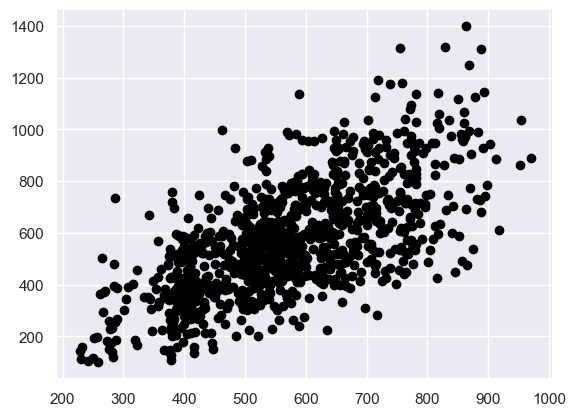

In [100]:
from sklearn.metrics import mean_squared_error, r2_score
# Predicciones para test modelo completo
vinos_y_pred = modeloC.predict(X_test)
print("Root mean squared error: %.2f" % np.sqrt(mean_squared_error(y_test, vinos_y_pred)))
print("Coefficient of determination: %.2f" % r2_score(y_test, vinos_y_pred))
plt.scatter(vinos_y_pred, y_test, color="black")